In [1]:
import os
import sys
import pandas as pd
import matplotlib
import seaborn as sns
import pickle
import numpy as np
import matplotlib as mpl
from matplotlib import pyplot as plt
from itertools import product
import glob
import re
from matplotlib_venn import venn2
from matplotlib import rcParams
import inspect
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
sys.setrecursionlimit(3000)
sns.set_context('notebook')
%load_ext autoreload
%autoreload 2
rcParams['figure.figsize'] = 8, 6
#rcParams['font.family'] = 'sans-serif'
#rcParams['font.sans-serif'] = ['Tahoma']
import tqdm
### notebook specific configuration ###
from os.path import basename
mpl.style.use('fivethirtyeight')

from Modules.Homer import *

sys.path.append('/home/isshamie/software/NGS-Pipeline')

data_folder = '/data/isshamie/CH_tissue_TSS/'

ref_fa = '/data/genome/hamster/picr/picr.fa'
annotation = '/data/genome/hamster/picr/updated_final_sort.gff3'
tss_annotation = '/data/isshamie/genome/start_site_mRNA_updated_final_sort.tsv'
mrna_peak = '/data/isshamie/TSS_CHO/mRNA.peak'

tissues = ['BloondnegSpleen','BMDM1hKLA1','BMDMwt','Brain','Brain7neg1',
          'FemaleReproductive','Heart','Intestine','Kidney','Liver','Lung',
           'MiscOrgans','Muscle','Pancreas','Skin','Spleen','Total','CHO']

len(tissues)

### Load in meta_sampe

meta_samples = pd.read_csv('Results/meta_samples.csv',index_col=0)

long_meta_samples = pd.read_csv('Results/long_meta_samples.csv',index_col=0)


/home/isshamie/software/anaconda2/lib/python2.7/site-packages/matplotlib/__init__.py:1405: UserWarning: 
This call to matplotlib.use() has no effect because the backend has already
been chosen; matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

  warnings.warn(_use_error_msg)


In [2]:
secM_genes = pd.read_csv('/data/isshamie/CH_tissue_TSS/Supplemental_Data/amir.low.exp.csv',index_col=0)
secM_genes.head()

,humanID,choID,mean.read.count,is.secM.Amir
humanSymbol,,,,
A3GALT2,127550,100774283,0.114583,True
ABO,28,100772592,0.437500,True
ABO,28,100754666,0.437500,True
ABO,28,100758032,0.437500,True
AGAP2,116986,100764978,0.875000,True


In [3]:
secM_genes

,humanID,choID,mean.read.count,is.secM.Amir
humanSymbol,,,,
A3GALT2,127550,100774283,0.114583,True
ABO,28,100772592,0.437500,True
ABO,28,100754666,0.437500,True
ABO,28,100758032,0.437500,True
AGAP2,116986,100764978,0.875000,True
AGR2,10551,100769015,0.000000,True
AGR3,155465,100768729,0.541667,True
AP3B2,8120,100759367,0.229167,True
AP3M2,10947,100751069,0.114583,True


In [4]:
gene_pd = pickle.load(open("Results/gene_pd.p",'rb'))

In [5]:
gene_pd.head()

,Peaks,Number of Peaks,Tissues,minDistance,sameStrandPeaks,minDistancePeak,maxValue,Peaks within -1kb:+100bp,tissues,hasGene,Number of SS
SERHL,"[Merged-picr_74-10067740-3, Merged-picr_0-2095...",9,NaN,31,"[Merged-picr_74-10067740-3, Merged-picr_0-2095...",Merged-picr_0-20958-19,NaN,"[Merged-picr_74-10067740-3, Merged-picr_0-2095...","[BloondnegSpleen_GRO, BMDM1hKLA1_GRO, BMDMwt_G...",True,2
RRP7A,"[Merged-picr_10-20507340-5, Merged-picr_10-210...",27,NaN,-19,"[Merged-picr_0-44492-5, Merged-picr_0-45924-1]",Merged-picr_0-44492-5,NaN,"[Merged-picr_0-44634-10, Merged-picr_0-44492-5...","[BloondnegSpleen_GRO, BMDM1hKLA1_GRO, BMDMwt_G...",True,2
POLDIP3,"[Merged-picr_0-78615-16, Merged-picr_0-98823-1...",46,NaN,46,"[Merged-picr_0-98823-17, Merged-picr_0-78294-1...",Merged-picr_0-78294-15,NaN,"[Merged-picr_0-98823-17, Merged-picr_0-98958-1...","[BloondnegSpleen_GRO, BMDM1hKLA1_GRO, BMDMwt_G...",True,4
CYB5R3,"[Merged-picr_0-94356-1, Merged-picr_0-92870-1,...",17,NaN,5,"[Merged-picr_0-92205-1, Merged-picr_0-91214-1]",Merged-picr_0-92205-1,NaN,"[Merged-picr_0-92205-1, Merged-picr_0-91214-1]","[BloondnegSpleen_GRO, BMDMwt_GRO]",True,2
A4GALT,"[Merged-picr_0-185729-11, Merged-picr_0-183445...",42,NaN,-5,"[Merged-picr_0-185729-11, Merged-picr_0-186286...",Merged-picr_0-186286-5,NaN,"[Merged-picr_0-185729-11, Merged-picr_0-185806...","[BloondnegSpleen_GRO, BMDM1hKLA1_GRO, BMDMwt_G...",True,3


In [6]:
anno_peaks = pd.read_csv('Results/peaks_with_tss_and_gene.tsv',sep='\t',index_col=0)
#anno_peaks = anno_peaks[['Chr','Start','End','Strand','Peak Score','Nearest TSS','isSameStrand','Distance to TSS']]
anno_peaks = anno_peaks[~anno_peaks['Nearest TSS'].isnull()]

## Get genes that are in the new genome

In [7]:
print('secM genes not in the CHO genome:')
secM_genes[~secM_genes.index.isin(gene_pd.index)]

secM genes not in the CHO genome:


,humanID,choID,mean.read.count,is.secM.Amir
humanSymbol,,,,
PDIA2,64714,100773412,0.28125,True


In [8]:
secM = secM_genes[secM_genes.index.isin(gene_pd.index)]
secM = secM[~secM.index.duplicated()]

In [9]:
secM

,humanID,choID,mean.read.count,is.secM.Amir
humanSymbol,,,,
A3GALT2,127550,100774283,0.114583,True
ABO,28,100772592,0.437500,True
AGAP2,116986,100764978,0.875000,True
AGR2,10551,100769015,0.000000,True
AGR3,155465,100768729,0.541667,True
AP3B2,8120,100759367,0.229167,True
AP3M2,10947,100751069,0.114583,True
ARAP2,116984,100751597,0.166667,True
B4GALNT1,2583,100764682,0.072917,True


In [10]:
tss = pd.read_csv(tss_annotation,sep='\t',index_col=0)

In [11]:
peak_tissue_matrix = pd.read_csv('Results/merged_samples/peaks_tissues.csv',index_col=0,sep=',')
cho = peak_tissue_matrix.loc[:,peak_tissue_matrix.columns.str.contains('CHO')]

## Need to re-run the Distance to TSS because the negative strand was looking at the terminal region.
## Assuming the gene_id and transcript didnt change, which may not be the case for two nearby genes

In [12]:
## Need to re-run the Distance to TSS because the negative strand was looking at the terminal region.
## Assuming the gene_id and transcript didnt change, which may not be the case for two nearby genes
anno_peaks_properDistance = anno_peaks.copy()
for ind,val in secM.iterrows():
    #print ind
    curr_peaks = anno_peaks[anno_peaks['Nearest gene']==ind]
    
    for ind2,val2 in curr_peaks.iterrows():
        curr_txn = tss[tss['transcript_id'] == val2['Nearest TSS']]
        peak_start = (val2['Start']+val2['End'])/2
        if curr_txn['Strand'][0] == '+':
            dist = peak_start - curr_txn['Start']
        elif curr_txn['Strand'][0] == '-':
            dist = curr_txn['End'] - peak_start
            
        else:
            print('Strand information not here')
        dist = dist.get_values()[0]

        anno_peaks_properDistance.set_value(ind2,'Distance to TSS',dist)
        


In [12]:
anno_peaks = anno_peaks_properDistance

In [12]:
secM_tss = gene_pd.loc[secM.index]

### This is part of fixing it up by correcting sameStrandPeaks which are w/in the promoter range

In [15]:
def get_genes_peaks(peaks,gene,distance=[-1000,+100]):
    filt = peaks[(peaks['Nearest gene'] == gene) & 
                 ((peaks['Distance to TSS'] > distance[0]) & (peaks['Distance to TSS'] < distance[1]))]
    return filt

In [16]:
for curr_gene,val in secM_tss.iterrows():
    ## Filter to only within the distance of -1kb to +100bp
    curr = get_genes_peaks(anno_peaks_properDistance,curr_gene)
    secM_tss.set_value(curr_gene,'Peaks within -1kb:+100bp',list(curr.index))

    ## isSameStrand 
    same_strand = curr[curr['isSameStrand'] == True]
    secM_tss.set_value(curr_gene,'sameStrandPeaks',list(same_strand.index))

    try: 
        curr_tissues = peak_tissue_matrix.columns[(peak_tissue_matrix.loc[curr.index]>0).any()].values
        curr_tissues = map(lambda x: x.split('/')[0] + '_' + x.split('/')[1],curr_tissues)
        secM_tss.set_value(curr_gene,'tissues',curr_tissues)
    except KeyError :
        print curr.index + ' not in peak expression file. Maybe it was dropped from being a duplicate? Or no peak had a value in it.'

secM_tss['hasGene'] = secM_tss.fillna('')['sameStrandPeaks'].apply(lambda x: len(x) > 0)

In [13]:
print('Number of genes: ', len(secM_tss))
print('Number of genes with a peak: ', np.sum(secM_tss['hasGene']))

('Number of genes: ', 57)
('Number of genes with a peak: ', 40)


### Distance of -1000:+100

('More than one gene_id for this gene: ', 'ABO')


/home/isshamie/software/anaconda2/lib/python2.7/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


('More than one gene_id for this gene: ', 'AGAP2')


/home/isshamie/software/anaconda2/lib/python2.7/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


('More than one gene_id for this gene: ', 'ERP27')
('More than one gene_id for this gene: ', 'PSD4')
('More than one gene_id for this gene: ', 'RAB39A')
('More than one gene_id for this gene: ', 'TBC1D30')
('Number of genes in CHO with a peak nearby: ', 24)
('Number of genes in CHO with a peak in promoter region -1kb:+100: ', 4)


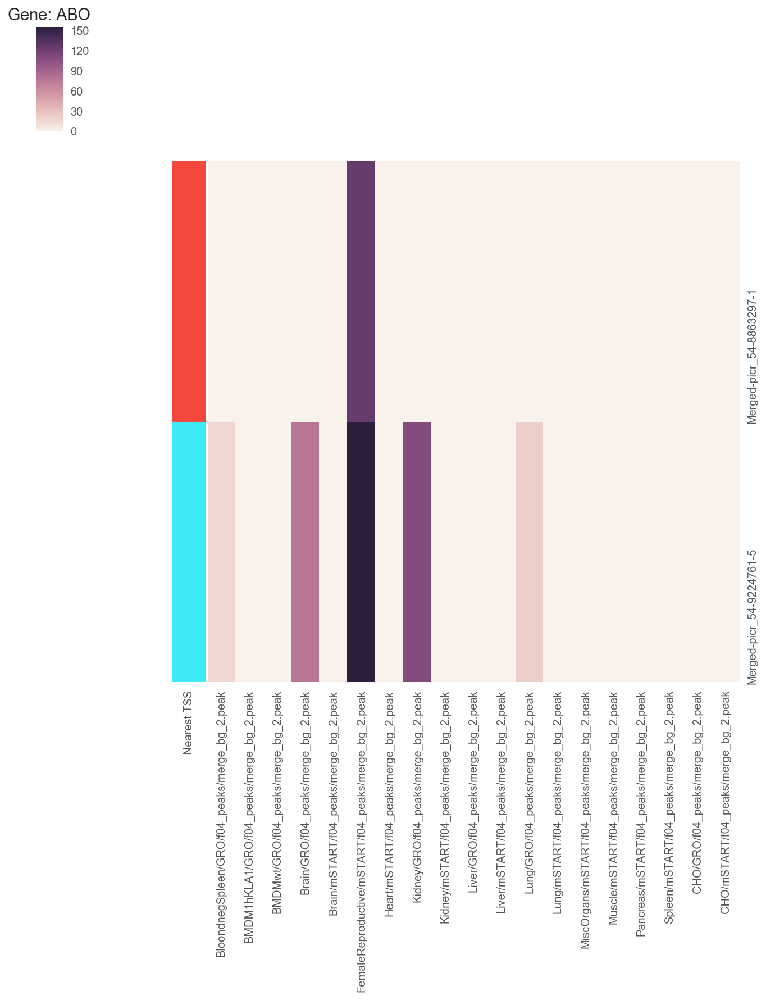

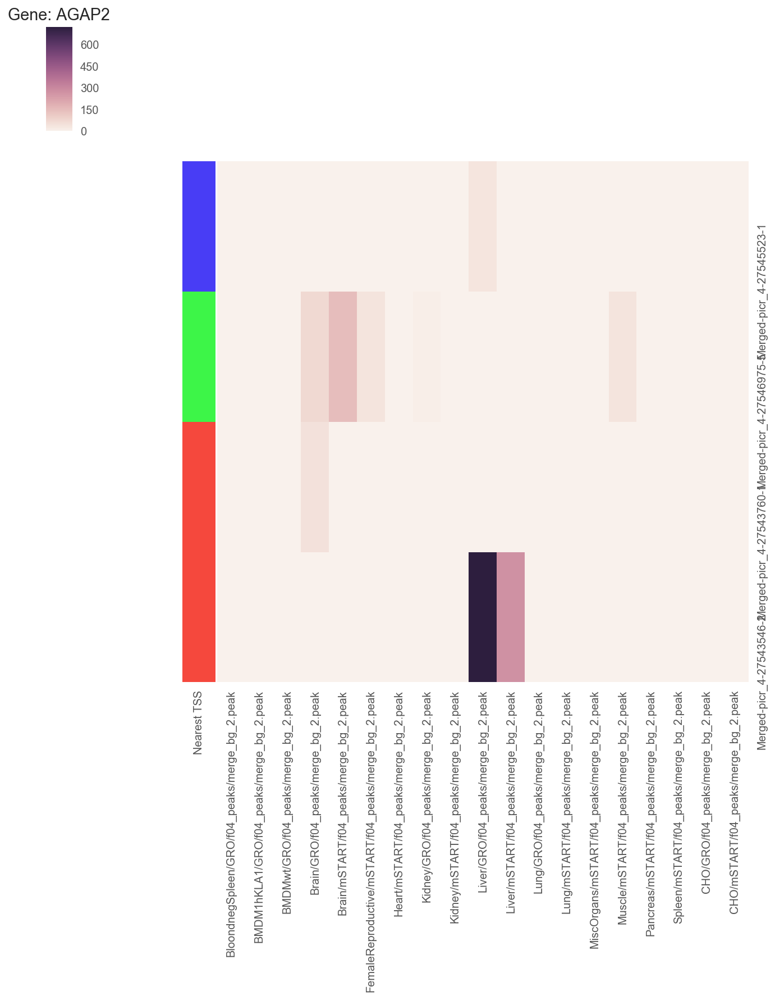

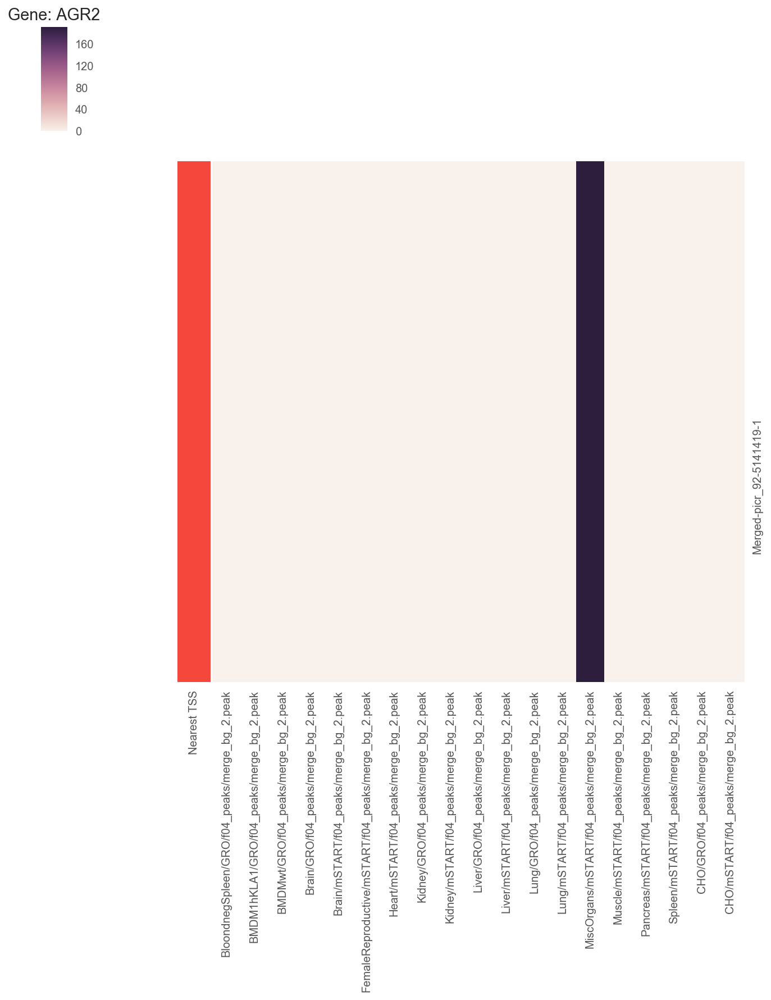

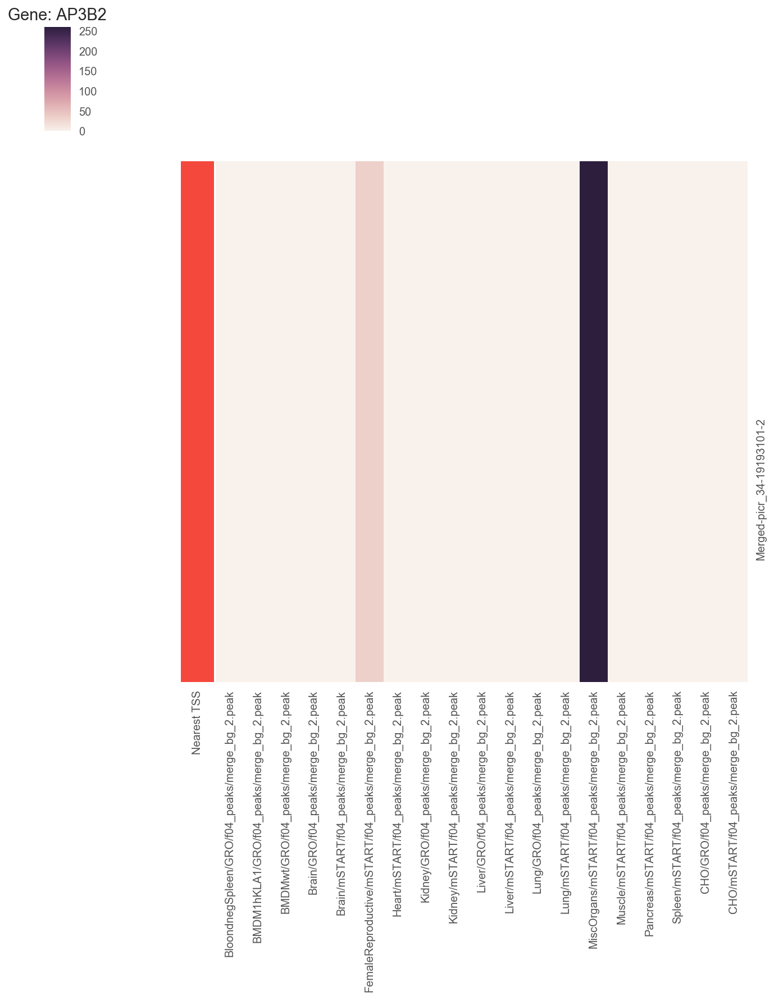

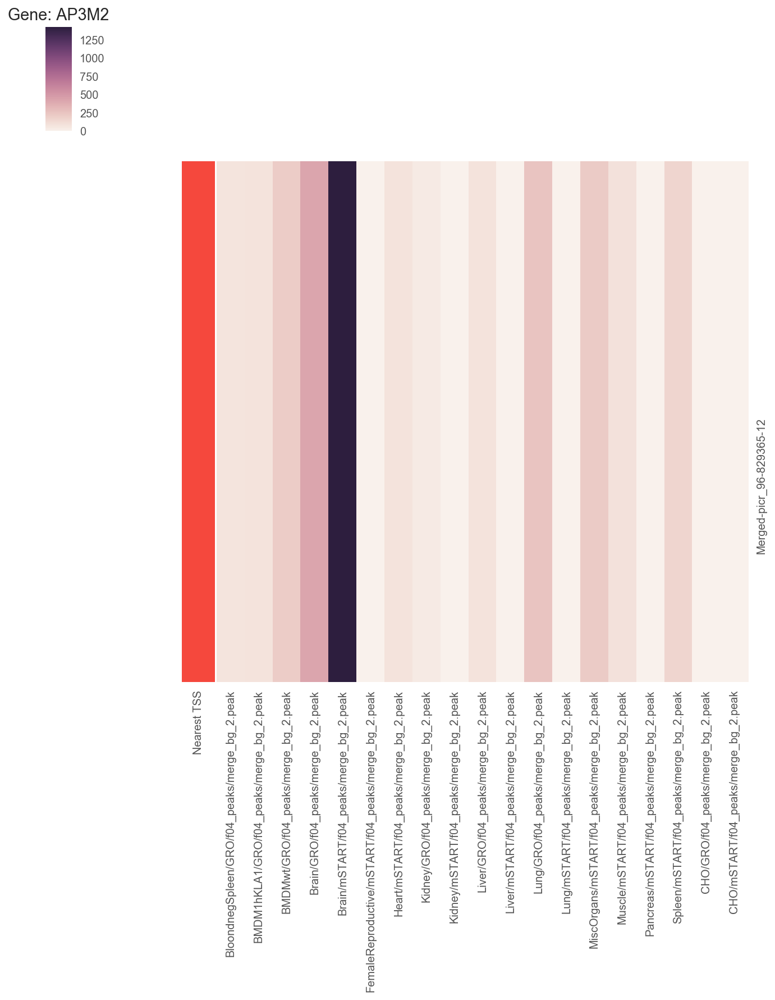

...

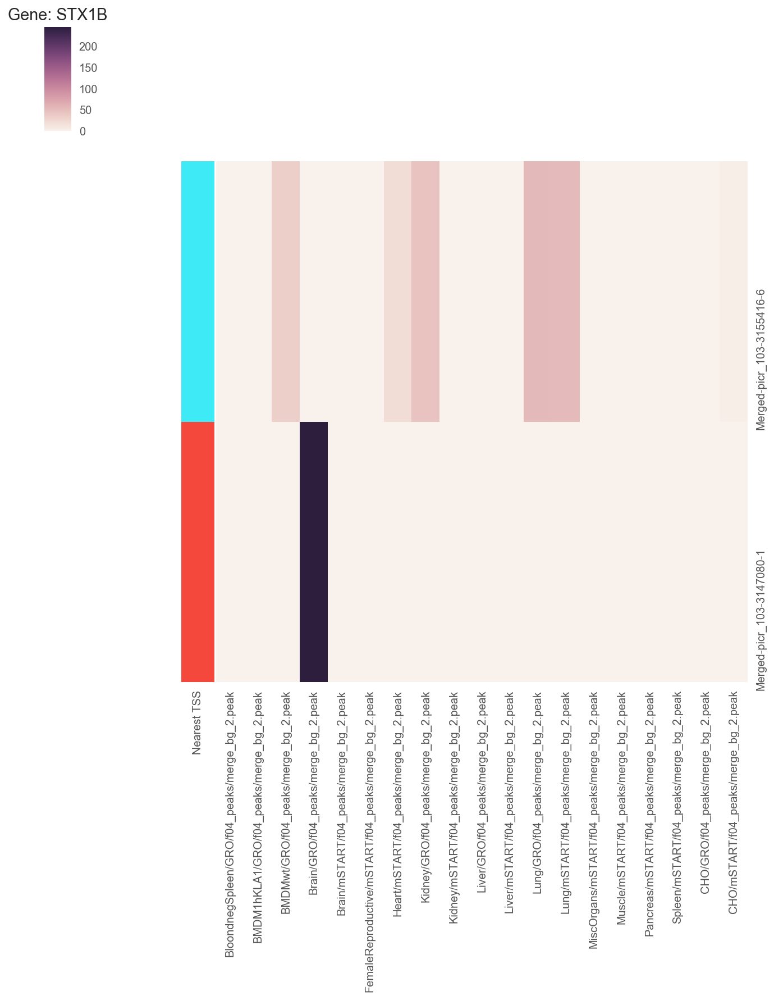

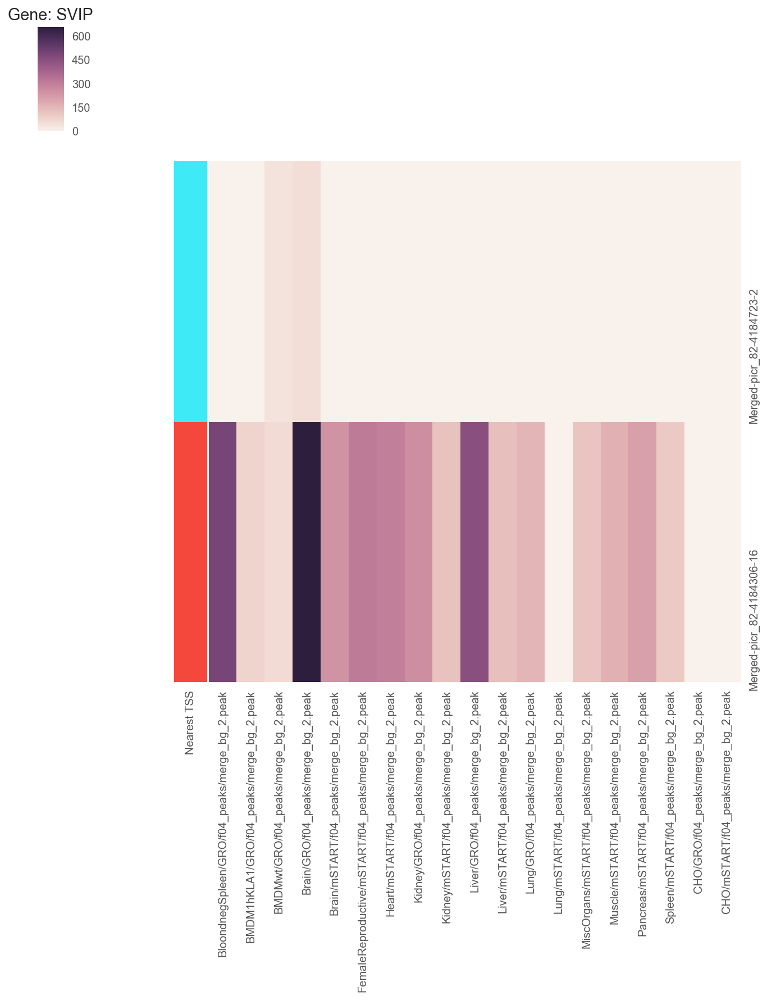

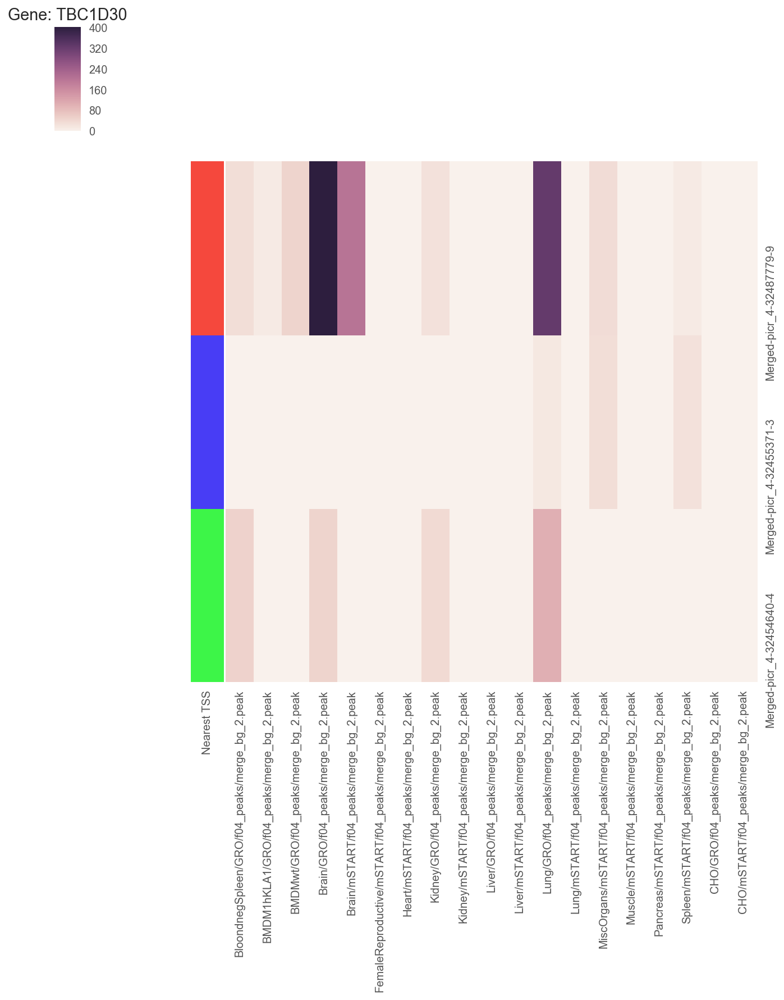

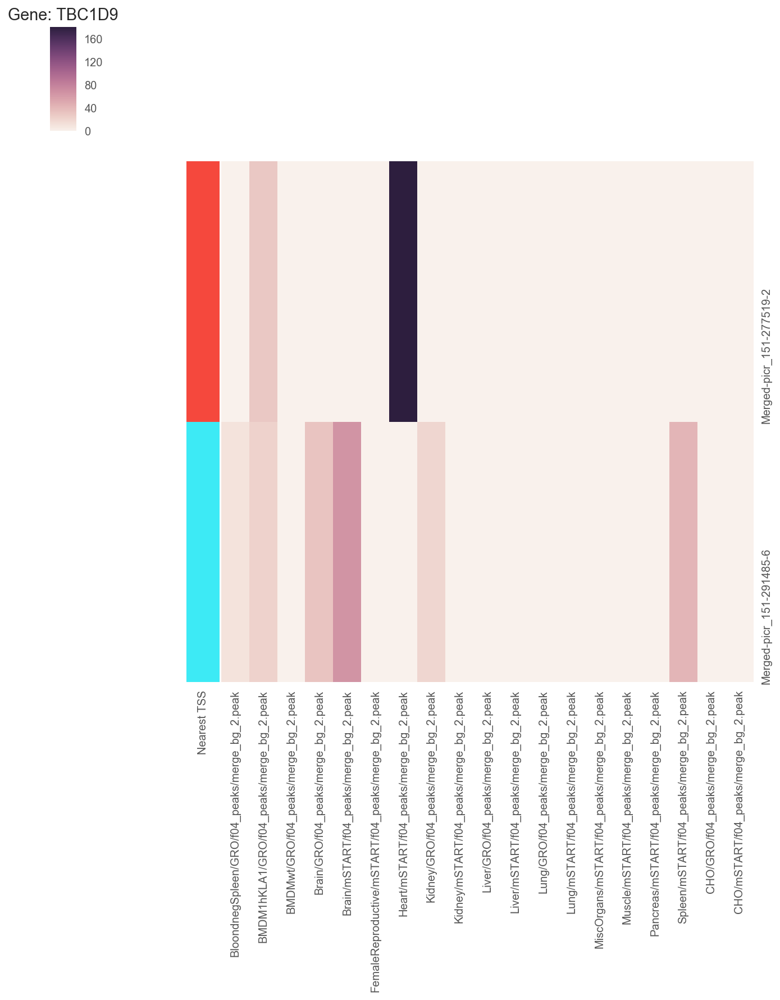

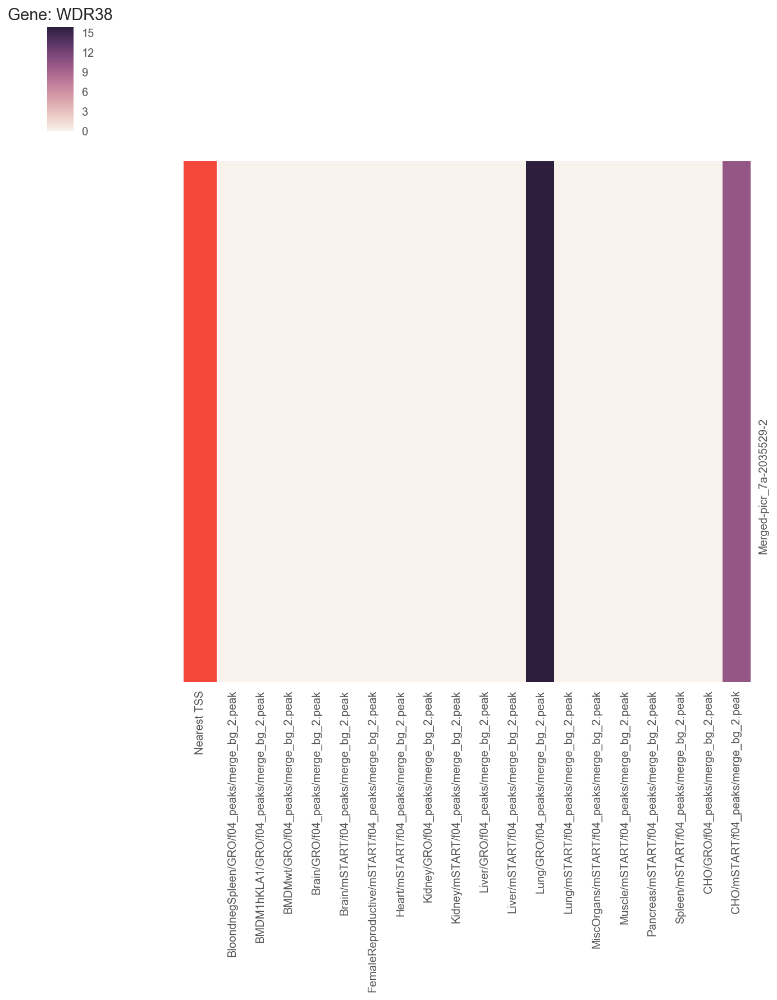

In [14]:
secM_has_peak = secM_tss[secM_tss['hasGene']] #Ones that have gene
secM_has_peak = secM_has_peak[~secM_has_peak.index.duplicated()]
secM_has_peak['is_in_cho_all'] = False
secM_has_peak['is_in_cho_promoter'] = False
secM_has_peak['loc_differences'] = [[] for _ in range(secM_has_peak.shape[0])]
secM_has_peak['loc_differences'] = secM_has_peak['loc_differences'].astype(object)
#secM_has_peak['loc_differences'] = ''
count = 0
for ind,val in secM_has_peak.iterrows():
    curr_gene_peaks = peak_tissue_matrix[peak_tissue_matrix.index.isin(val['sameStrandPeaks'])] #These peaks are same strand as gene and within proper distance
    is_in_cho_wideRange = cho[cho.index.isin(val['Peaks'])]
    is_in_cho_promoter = cho[cho.index.isin(val['sameStrandPeaks'])]
    
    if np.sum(np.sum(is_in_cho_wideRange>0)) > 0:
        secM_has_peak.set_value(ind,'is_in_cho_all', True)
    if np.sum(np.sum(is_in_cho_promoter>0)) > 0:
        secM_has_peak.set_value(ind,'is_in_cho_promoter', True)        


    curr_anno = anno_peaks[anno_peaks.index.isin(curr_gene_peaks.index)] 
    curr_txn = curr_anno['Nearest TSS']#anno_peaks[anno_peaks.index.isin(curr_gene_peaks.index)]['Nearest TSS']

    ## Determine the distance of adjacent peaks
    if len(curr_anno) > 1:
        if len(curr_anno.groupby('Nearest gene_id')) > 1:
            print('More than one gene_id for this gene: ',ind) 
        
        
        for ind2,val2 in curr_anno.groupby('Nearest TSS'):
            if len(val2) > 1:
                val2 = val2.sort_values(['Start','End'])
                diff = val2['Start'].diff().values
                secM_has_peak.at[ind,'loc_differences'] = list(diff[1:])
    
    
    lut = dict(zip(curr_txn.unique(), sns.hls_palette(len(curr_txn.unique()),s=0.9)))
    row_colors = curr_txn.map(lut)  
    
    #sns.heatmap(curr_gene_peaks,row_cluster=False,ax=ax)
    f = plt.figure()
    cg = sns.clustermap(curr_gene_peaks,row_colors=row_colors,row_cluster=False,col_cluster = False)
    ax = plt.gca()
    ax.set_title('Gene: ' + ind)

    #sns.clustermap(curr_gene_peaks,ax=ax,row_colors=row_colors,row_cluster=False,col_cluster=False)
    #ax.set_title('Gene: ' + ind)
    
    cg.savefig('Results/secM_lowExpressed_genes/'+ ind + '.png')
    
print('Number of genes in CHO with a peak nearby: ', np.sum(secM_has_peak['is_in_cho_all']))
print('Number of genes in CHO with a peak in promoter region -1kb:+100: ', np.sum(secM_has_peak['is_in_cho_promoter']))


In [15]:
secM_has_peak['loc_differences']

humanSymbol
ABO               []
AGAP2        [214.0]
AGR2              []
AP3B2             []
AP3M2             []
ARAP2        [371.0]
B4GALNT1     [492.0]
B4GALNT2          []
CRYAA             []
CYTH4             []
DPP6         [358.0]
EIF2AK2      [351.0]
ERP27             []
GALNT12           []
GALNT15           []
GALNT6       [670.0]
GLT1D1            []
HAS2              []
IQSEC3            []
MGAT3             []
PSD4         [662.0]
RAB11FIP1         []
RAB11FIP4         []
RAB15             []
RAB17        [160.0]
RAB25             []
RAB26             []
RAB33A            []
RAB39A       [333.0]
RAB3C        [892.0]
RAB6B        [639.0]
RAB9B        [461.0]
SGSM1             []
SNAP25            []
STX19             []
STX1B             []
SVIP              []
TBC1D30           []
TBC1D9            []
WDR38             []
Name: loc_differences, dtype: object

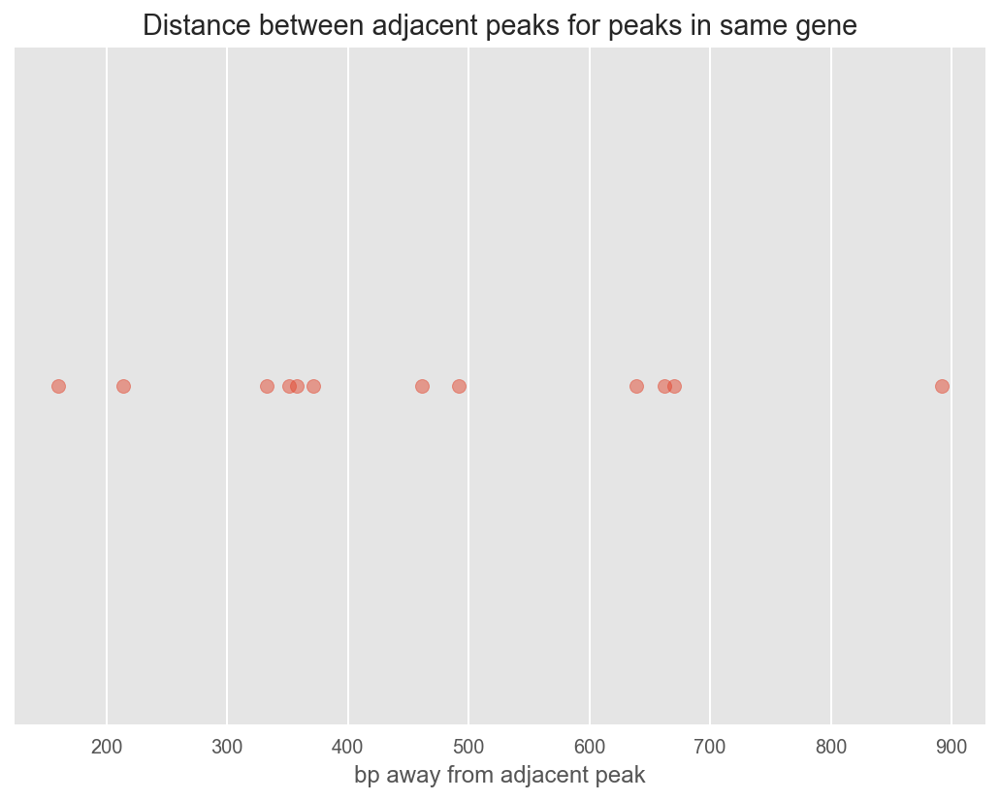

In [57]:
loc_dif = []
for x in  secM_has_peak['loc_differences']:
    loc_dif.extend(x) 

f,ax = plt.subplots()
ax.scatter(loc_dif,np.ones([len(loc_dif),]),alpha=0.5)
ax.set_xlabel('bp away from adjacent peak')
ax.set_ylim([1,1])
ax.set_yticks([])
ax.set_title('Distance between adjacent peaks for peaks in same gene')
plt.savefig('Results/secM_lowExpressed_genes/secM_distance_btwn_adj_peaks.png')

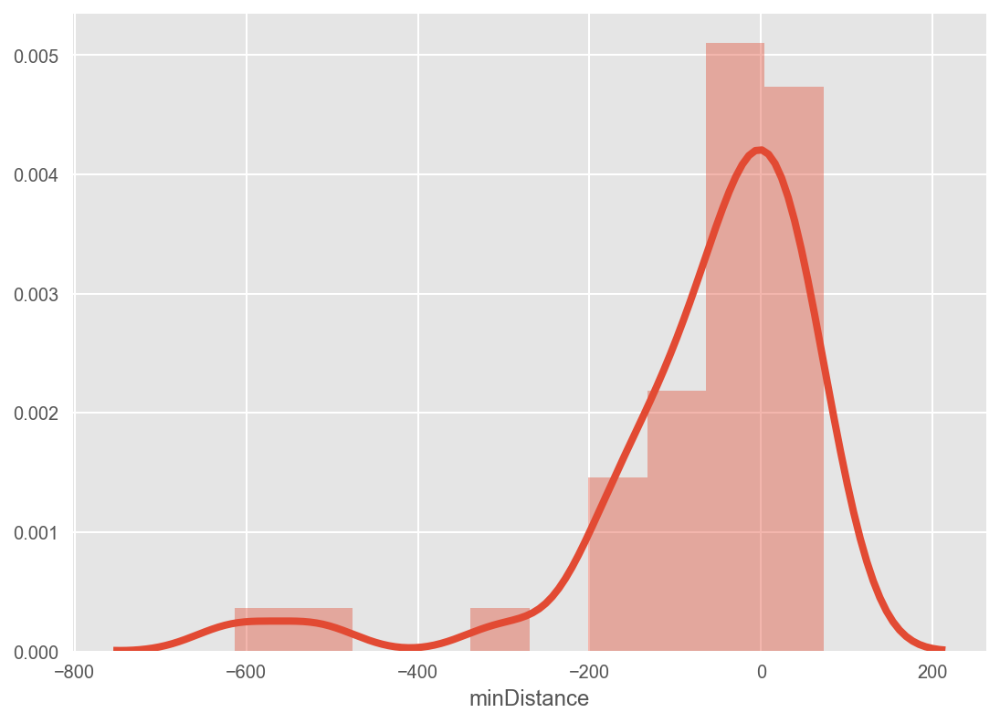

In [16]:
sns.distplot(secM_has_peak.minDistance)

In [17]:
tissues_gene = dict()
for tis in peak_tissue_matrix.columns.values:
    t = tis.split('/')[0] + '_' + tis.split('/')[1]
    tissues_gene[t] = 0

for i in secM_has_peak['tissues']:
    for j in i:
        tissues_gene[j] += 1
tissues_gene

{'BMDM1hKLA1_GRO': 14,
 'BMDMwt_GRO': 16,
 'BloondnegSpleen_GRO': 19,
 'Brain_GRO': 31,
 'Brain_mSTART': 22,
 'CHO_GRO': 2,
 'CHO_mSTART': 4,
 'FemaleReproductive_mSTART': 12,
 'Heart_mSTART': 8,
 'Kidney_GRO': 24,
 'Kidney_mSTART': 4,
 'Liver_GRO': 12,
 'Liver_mSTART': 4,
 'Lung_GRO': 23,
 'Lung_mSTART': 5,
 'MiscOrgans_mSTART': 18,
 'Muscle_mSTART': 9,
 'Pancreas_mSTART': 3,
 'Spleen_mSTART': 19}

In [18]:
secM_has_peak['tissues'].apply(lambda x:len(x))

humanSymbol
ABO           5
AGAP2         7
AGR2          1
AP3B2         3
AP3M2        12
ARAP2         9
B4GALNT1     11
B4GALNT2      6
CRYAA         1
CYTH4        10
DPP6          5
EIF2AK2       8
ERP27         3
GALNT12       9
GALNT15       9
GALNT6        6
GLT1D1        4
HAS2          1
IQSEC3        2
MGAT3         3
PSD4          6
RAB11FIP1    10
RAB11FIP4     9
RAB15         2
RAB17         4
RAB25         3
RAB26         5
RAB33A        1
RAB39A       13
RAB3C         4
RAB6B         6
RAB9B         2
SGSM1         4
SNAP25       13
STX19         6
STX1B        11
SVIP         16
TBC1D30       9
TBC1D9        7
WDR38         3
Name: tissues, dtype: int64

## Using the nearest peak, no distance. See if the ones that dont have a gene may have potential start site

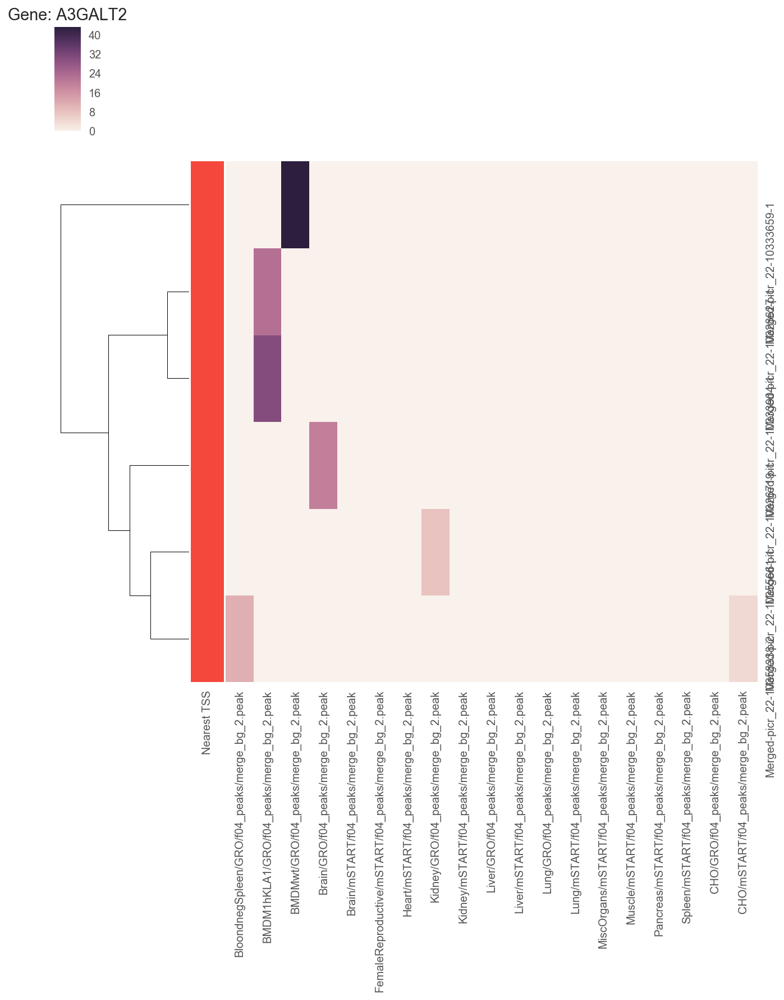

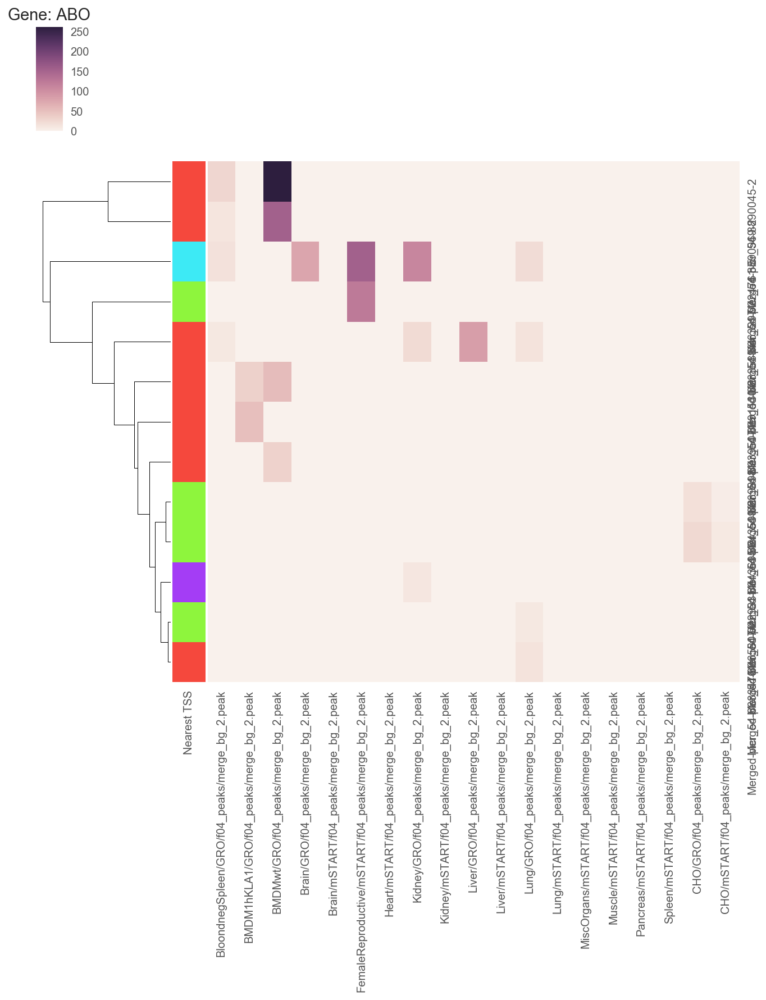

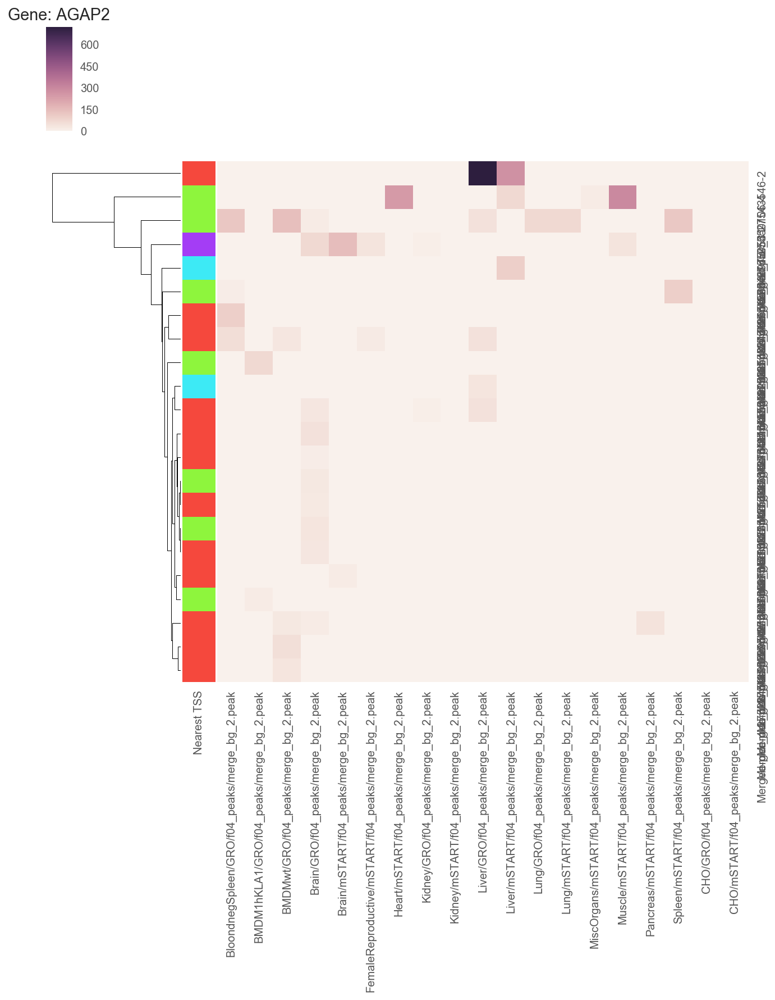

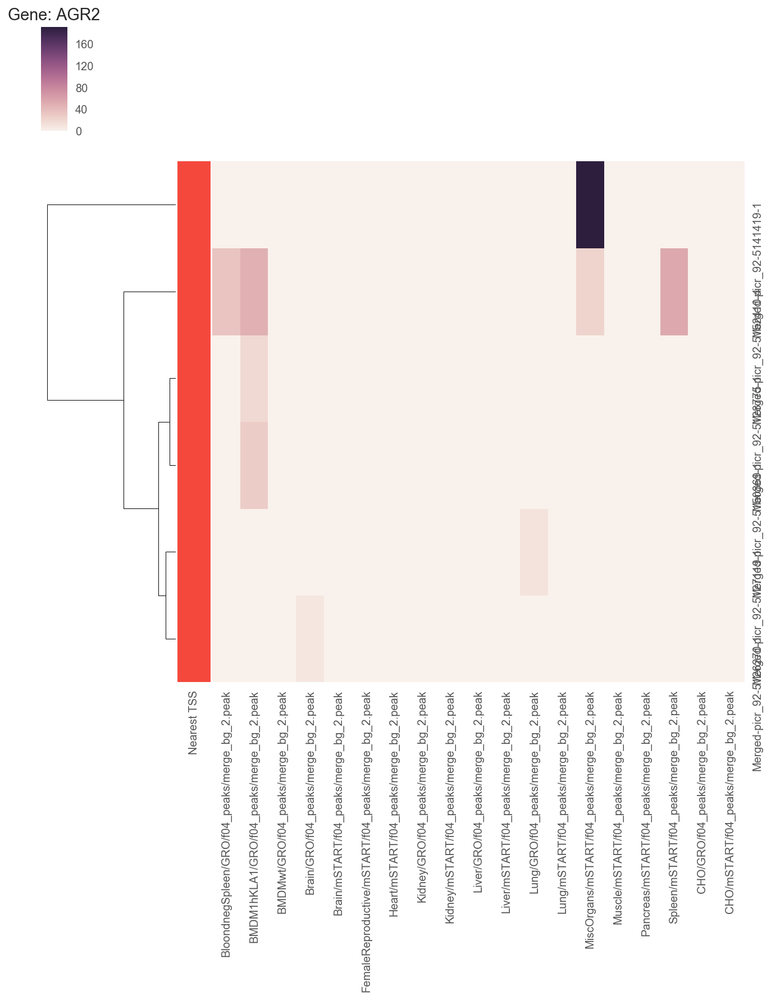

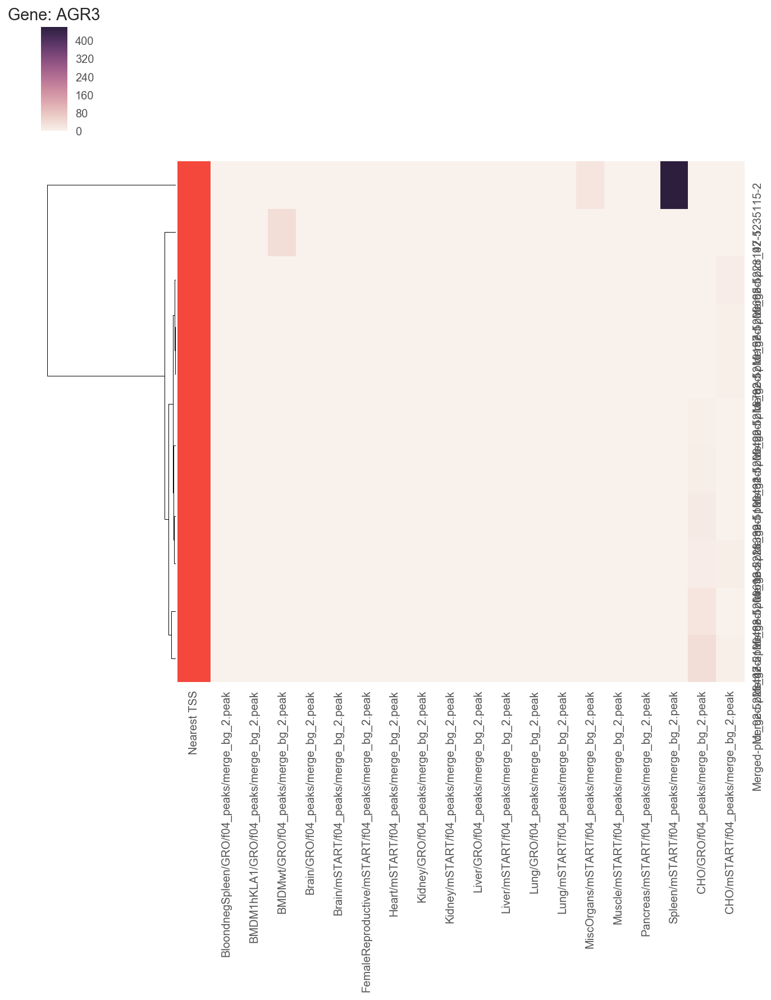

...

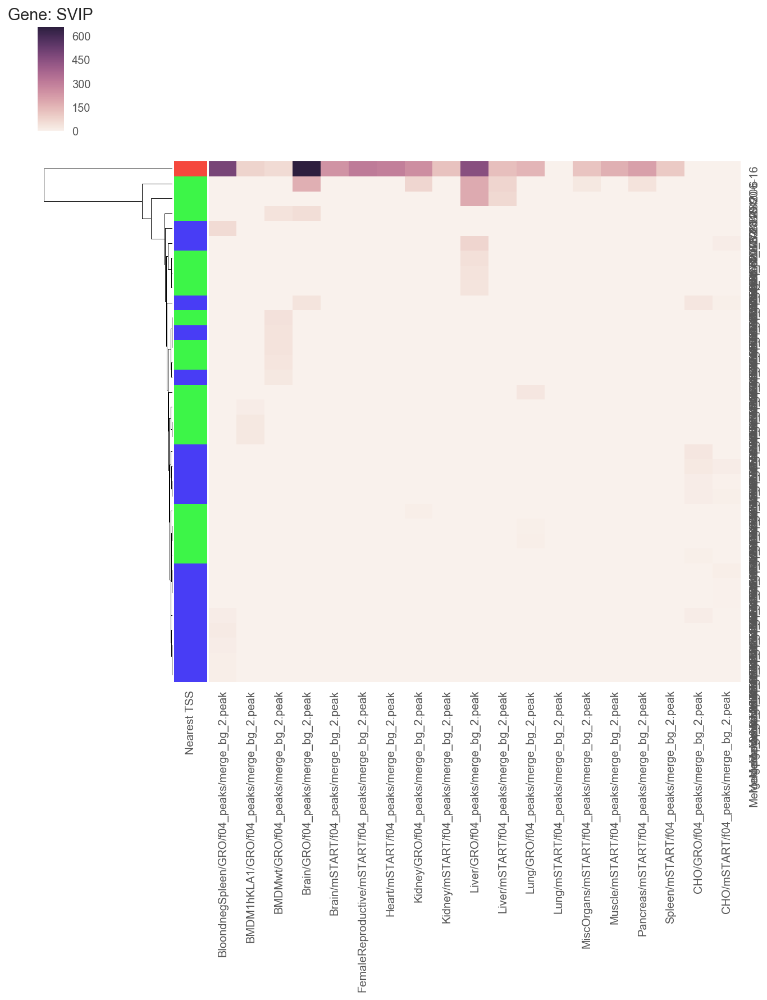

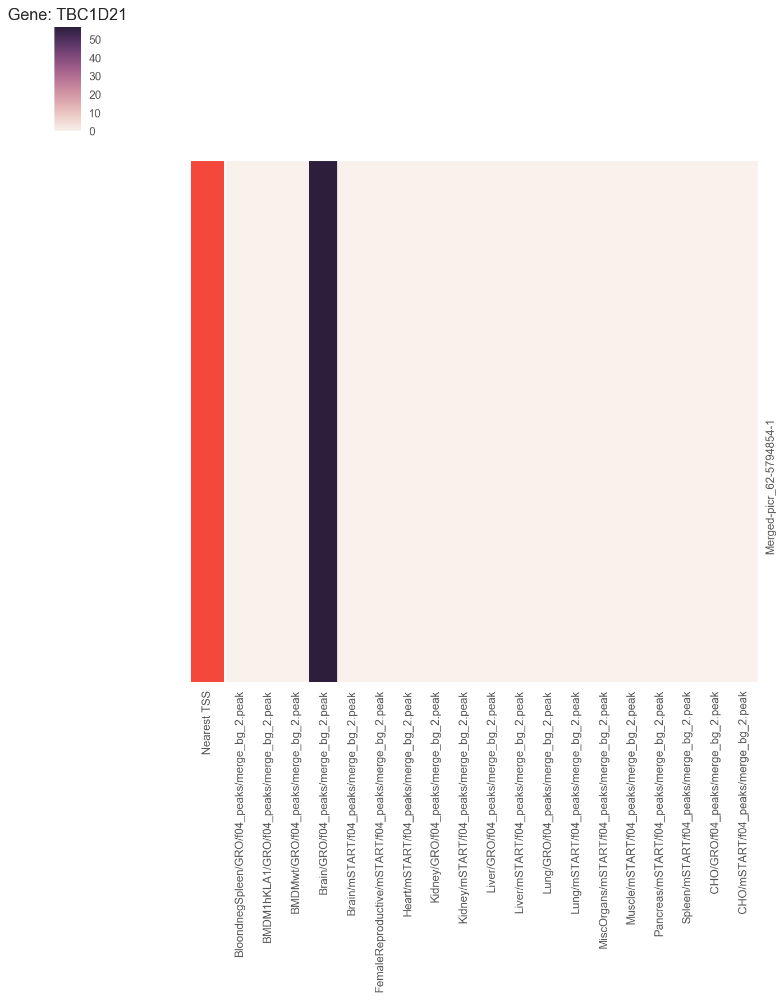

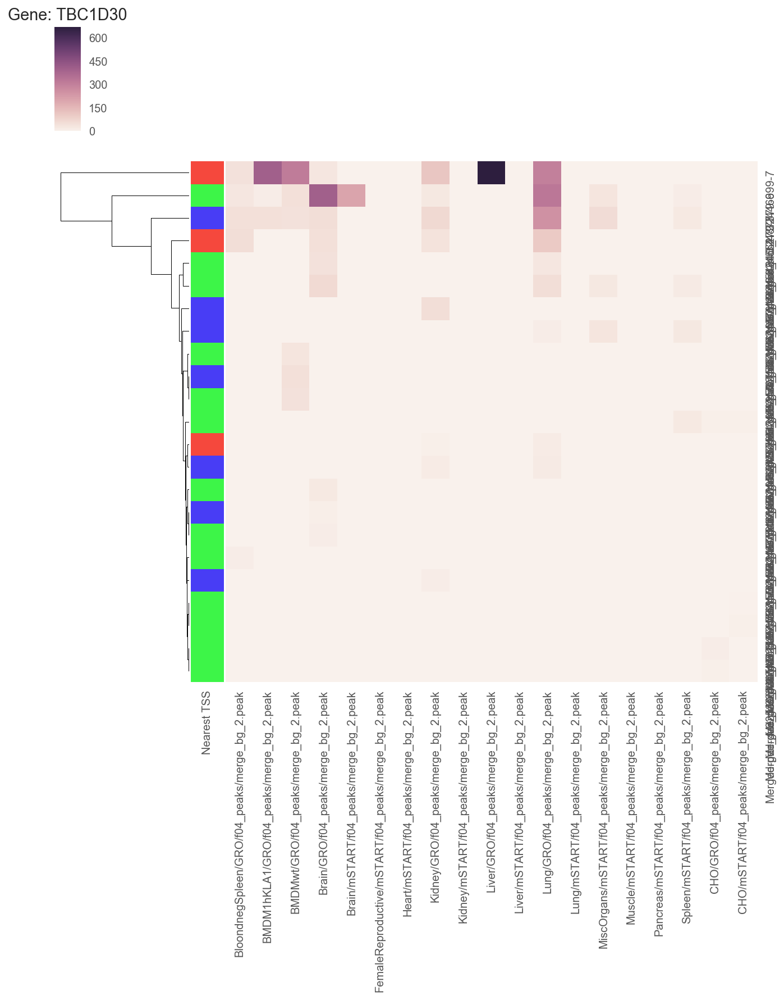

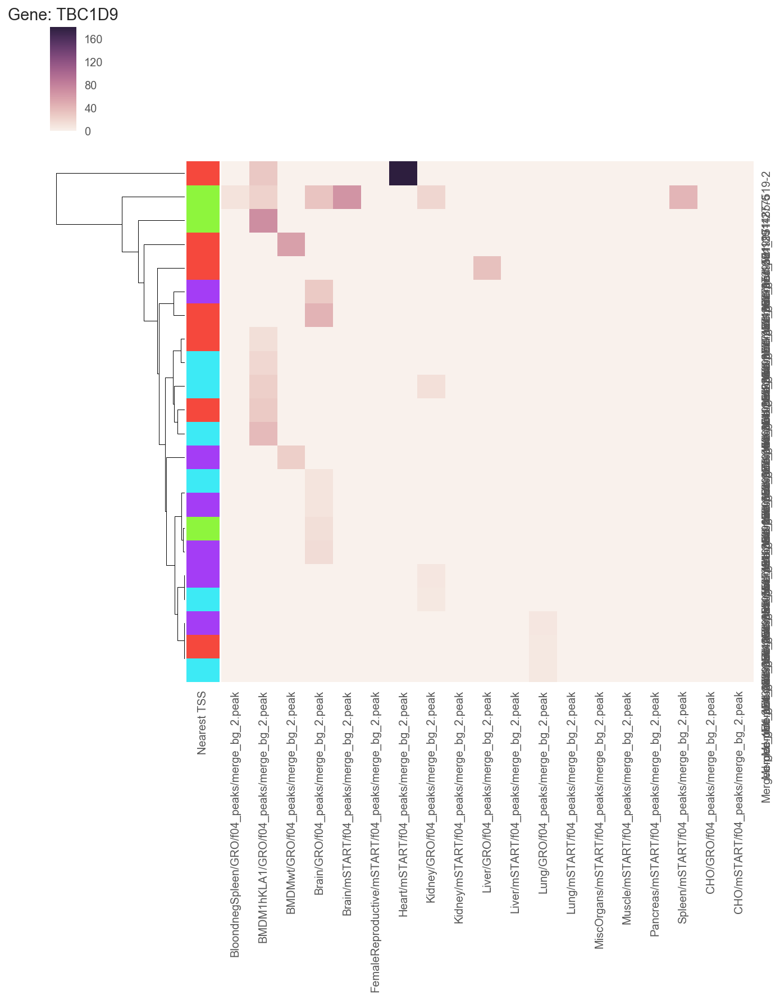

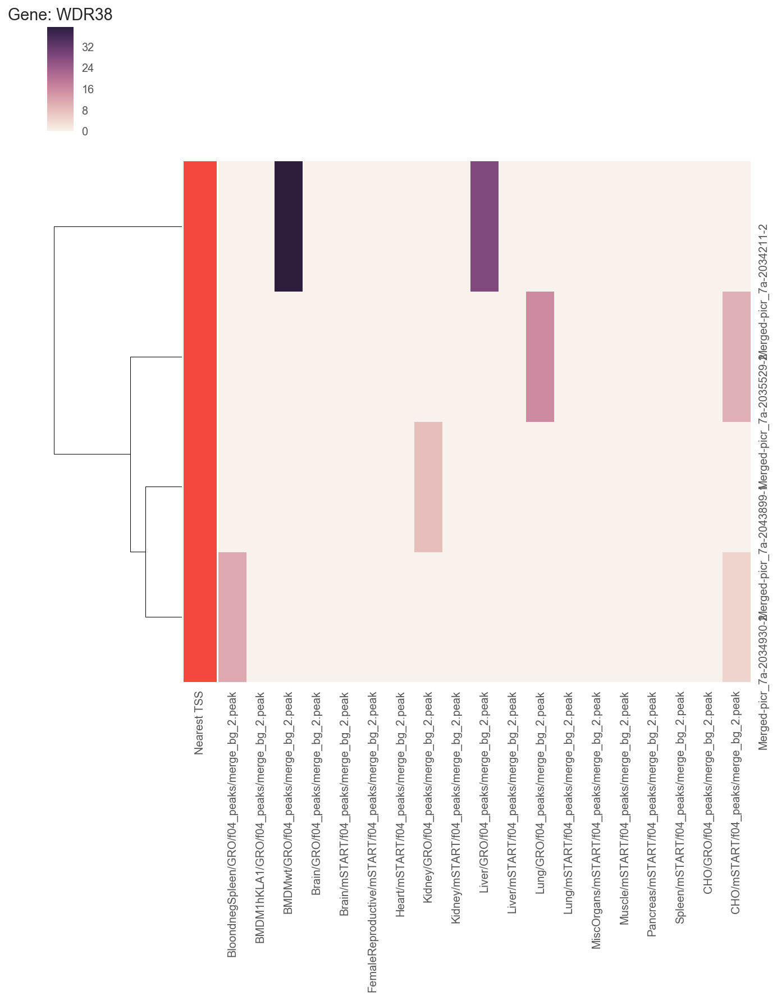

In [22]:
secM_all = secM_tss.copy()

for ind,val in secM_all.iterrows():
    if val['Number of Peaks'] == 0:
        continue
    curr_gene_peaks = peak_tissue_matrix[peak_tissue_matrix.index.isin(val['Peaks'])]
    
    f = plt.figure()

    curr_txn = anno_peaks[anno_peaks.index.isin(curr_gene_peaks.index)]['Nearest TSS']
    #lut = dict(zip(curr_txn.unique(), "rbg"))
    lut = dict(zip(curr_txn.unique(), sns.hls_palette(len(curr_txn.unique()),s=0.9)))
    row_colors = curr_txn.map(lut)    
    if len(curr_gene_peaks) <= 1:    
        cg = sns.clustermap(curr_gene_peaks,row_colors=row_colors,col_cluster = False,row_cluster=False)
    else:
        cg = sns.clustermap(curr_gene_peaks,row_colors=row_colors,col_cluster = False)
    ax = plt.gca()
    ax.set_title('Gene: ' + ind)
    cg.savefig('Results/secM_lowExpressed_genes/allAnno_'+ ind + '.png')
    #plt.savefig('Results/secM_lowExpressed_genes/allAnno_'+ ind + '.png',bbox_inches='tight')

## See where peaks of genes are for IGV

#### Not done yet

# Get peak start sites

In [23]:
secM_hasTSS = secM_tss[secM_tss['hasGene']] #Ones that have gene
secM_hasTSS = secM_hasTSS[~secM_hasTSS.index.duplicated()]
secM_hasTSS['is_in_cho_promoter'] = False
secM_hasTSS['maxPeak'] = ''
secM_hasTSS['Chr'] = ''
secM_hasTSS['Start'] = 0
secM_hasTSS['End'] = 0
secM_hasTSS['Strand'] = ''
secM_hasTSS['Distance to Annotated TSS'] = 0
secM_hasTSS['transcript_id'] = ''
secM_hasTSS['gene_id'] = ''


count = 0
for ind,val in secM_hasTSS.iterrows():
    curr_gene_peaks = peak_tissue_matrix[peak_tissue_matrix.index.isin(val['sameStrandPeaks'])]
    is_in_cho_wideRange = cho[cho.index.isin(val['Peaks'])]
    is_in_cho_promoter = cho[cho.index.isin(val['sameStrandPeaks'])]
    
    if np.sum(np.sum(is_in_cho_wideRange>0)) > 0:
        secM_hasTSS.set_value(ind,'is_in_cho_all', True)
    if np.sum(np.sum(is_in_cho_promoter>0)) > 0:
        secM_hasTSS.set_value(ind,'is_in_cho_promoter', True)        

    if len(curr_gene_peaks) > 1:
        max_peak = curr_gene_peaks.max(axis=1).argmax()
        max_value = curr_gene_peaks.max(axis=1).max()
    else:
        max_peak = curr_gene_peaks.index[0]
        max_value = curr_gene_peaks.max().max()
    tmp = anno_peaks.loc[max_peak]
    
    secM_hasTSS.set_value(ind,'maxValue',max_value)
    secM_hasTSS.set_value(ind,'transcript_id',tmp['Nearest TSS'])
    secM_hasTSS.set_value(ind,'gene_id',tmp['Nearest gene_id'])
    secM_hasTSS.set_value(ind,'Start',tmp['Start'])
    secM_hasTSS.set_value(ind,'End',tmp['End'])
    secM_hasTSS.set_value(ind,'Chr',tmp['Chr'])
    secM_hasTSS.set_value(ind,'Strand',tmp['Strand'])
    secM_hasTSS.set_value(ind,'Distance to Annotated TSS',tmp['Distance to TSS'])

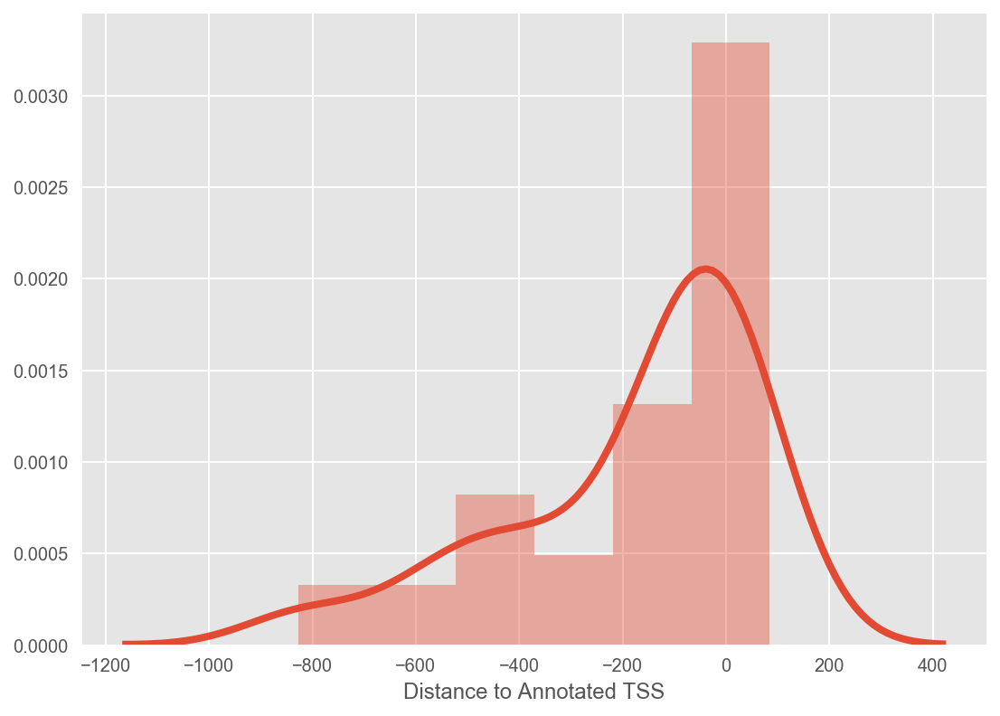

In [24]:
sns.distplot(secM_hasTSS['Distance to Annotated TSS'])

In [25]:
upstream = 1000

secM_bed = pd.DataFrame()
for ind,val in secM_hasTSS.iterrows():
    title = ind + ';' + val['transcript_id'] + ';' + val['gene_id'] + ';' + ','.join(val['tissues'])
    center = (val['Start'] + val['End'])/2
    
    if val['Strand'] == '+':
        start = center-upstream+1
        end = center
    elif val['Strand'] == '-':
        start = center 
        end = center + upstream + 1
    
    
    secM_bed = secM_bed.append({'chrom':val['Chr'], 
                                'chromStart': start,
                                'chromEnd':end,
                                'name':title,
                                'score': val['maxValue'],
                                'strand':val['Strand']},ignore_index=True)

    
secM_bed = secM_bed[['chrom','chromStart','chromEnd','name','score','strand']]
secM_bed['chromStart'] = secM_bed['chromStart'].astype(int)
secM_bed['chromEnd'] = secM_bed['chromEnd'].astype(int)

In [28]:
f_save = 'Results/secM_lowExpressed_genes/secM_lowExpress'
secM_bed.to_csv(f_save + '.bed',sep='\t',header=None,index=None)

In [29]:
cmd = 'homerTools extract %s %s -fa > %s' % (f_save + '.bed', ref_fa,f_save +'.fa')
print(cmd)
os.system(cmd)

homerTools extract Results/secM_lowExpressed_genes/secM_lowExpress.bed /data/genome/hamster/picr/picr.fa -fa > Results/secM_lowExpressed_genes/secM_lowExpress.fa


0

In [32]:
secM_bed

,chrom,chromStart,chromEnd,name,score,strand
0,picr_54,8862298,8863297,ABO;asmbl_62481;gene_22123;FemaleReproductive_...,124.950005,+
1,picr_4,27542547,27543546,"AGAP2;asmbl_51970;gene_18417_1;Brain_GRO,Kidne...",720.900024,+
2,picr_4,27470007,27471008,B4GALNT1;asmbl_51957;gene_18413;BloondnegSplee...,786.099976,-
3,picr_120,3224435,3225434,B4GALNT2;asmbl_14090;gene_4803_3;FemaleReprodu...,1032.250000,+
4,picr_84,6327642,6328643,CRYAA;asmbl_80548;gene_28535;MiscOrgans_mSTART,772.099976,-
5,picr_74,5827834,5828833,CYTH4;asmbl_74882;gene_26506;BloondnegSpleen_G...,5130.100098,+
6,picr_143,2558785,2559786,DPP6;asmbl_21119;gene_7080;Brain_GRO,22.500000,-
7,picr_75,5051152,5052151,EIF2AK2;asmbl_75568;gene_26713;BloondnegSpleen...,73.550003,+
8,picr_79,5473183,5474182,"ERP27;asmbl_76681;gene_27150_2;BMDM1hKLA1_GRO,...",21.200001,+
9,picr_18,21050972,21051971,"GALNT15;asmbl_27510;gene_9444;Brain_GRO,Brain_...",636.750000,+


In [26]:
secM_bed

,chrom,chromStart,chromEnd,name,score,strand
0,picr_54,9224768,9225769,ABO;asmbl_62490;gene_22130_1;BloondnegSpleen_G...,155.449997,-
1,picr_4,27542547,27543546,"AGAP2;asmbl_51970;gene_18417_1;Brain_GRO,Brain...",720.900024,+
2,picr_92,5141419,5142420,AGR2;asmbl_84765;gene_29927;MiscOrgans_mSTART,190.799988,-
3,picr_34,19193128,19194129,"AP3B2;asmbl_46581;gene_16524_1;Brain_GRO,Femal...",259.799988,-
4,picr_96,829359,830360,AP3M2;asmbl_86029;gene_30366;BloondnegSpleen_G...,1427.599976,-
5,picr_28,990364,991365,ARAP2;asmbl_40549;gene_14115;BloondnegSpleen_G...,121.799995,-
6,picr_4,27470007,27471008,B4GALNT1;asmbl_51956;gene_18413;BloondnegSplee...,786.099976,-
7,picr_120,3224435,3225434,B4GALNT2;asmbl_14090;gene_4803_3;FemaleReprodu...,1032.250000,+
8,picr_84,6327642,6328643,CRYAA;asmbl_80548;gene_28535;MiscOrgans_mSTART,772.099976,-
9,picr_74,5827834,5828833,CYTH4;asmbl_74882;gene_26506;BloondnegSpleen_G...,5130.100098,+


In [27]:
len(secM_bed)

40

## Notes from IGV

ABO:

TBC1D9: Back to back with another gene, peaks may have been placed there. Highest transcript was a small one at the end
  

### Scrap

In [28]:
anno_peaks.loc['Merged-picr_151-237183-1','Annotation']

'promoter-TSS (ID=asmbl_22767.exon3;Parent=asmbl_22767;gene_id=gene_7718_1;gene=TBC1D9;transcript_id=asmbl_22767)'

In [27]:
anno_peaks[anno_peaks['Nearest gene']== 'TBC1D9'] 

,Chr,Start,End,Strand,Peak Score,Focus Ratio/Region Size,Annotation,Distance to TSS,Nearest PromoterID,Nearest TSS,isSameStrand,Nearest gene,Nearest gene_id
PeakID (cmd=annotatePeaks.pl Results/merged_samples/all_peaks_merged.tsv /data/genome/hamster/picr/picr.fa -gff /data/genome/hamster/picr/updated_final_sort.gff3),,,,,,,,,,,,,
Merged-picr_151-182666-2,picr_151,182591,182741,-,206.300003,Kidney/GRO/f04_peaks/merge_bg_2.peak|Liver/GRO...,Intergenic,94909.0,ID=asmbl_22766.exon1;Parent=asmbl_22766;gene_i...,asmbl_22767,True,TBC1D9,gene_7718_1
Merged-picr_151-227014-1,picr_151,226939,227089,-,38.400002,BMDM1hKLA1/GRO/f04_peaks/merge_bg_2.peak,TTS (ID=asmbl_22767.exon5;Parent=asmbl_22767;g...,19538.0,ID=asmbl_22767.exon5;Parent=asmbl_22767;gene_i...,asmbl_22771,True,TBC1D9,gene_7718_2
Merged-picr_151-192144-2,picr_151,192009,192280,-,28.599998,BMDM1hKLA1/GRO/f04_peaks/merge_bg_2.peak|Brain...,TTS (ID=asmbl_22770.exon12;Parent=asmbl_22770;...,19417.0,ID=asmbl_22768.exon21;Parent=asmbl_22768;gene_...,asmbl_22770,True,TBC1D9,gene_7718_1
Merged-picr_151-237183-1,picr_151,237108,237258,-,28.100000,Brain/GRO/f04_peaks/merge_bg_2.peak,promoter-TSS (ID=asmbl_22767.exon3;Parent=asmb...,9369.0,ID=asmbl_22768.exon3;Parent=asmbl_22768;gene_i...,asmbl_22771,True,TBC1D9,gene_7718_2
Merged-picr_151-253097-1,picr_151,253022,253172,+,24.400000,BMDMwt/GRO/f04_peaks/merge_bg_2.peak,Intergenic,-6545.0,ID=asmbl_22771.exon1;Parent=asmbl_22771;gene_i...,asmbl_22771,False,TBC1D9,gene_7718_2
Merged-picr_151-224096-2,picr_151,223974,224218,-,18.650002,BMDM1hKLA1/GRO/f04_peaks/merge_bg_2.peak|Kidne...,TTS (ID=asmbl_22771.exon6;Parent=asmbl_22771;g...,22456.0,ID=asmbl_22767.exon6;Parent=asmbl_22767;gene_i...,asmbl_22771,True,TBC1D9,gene_7718_2
Merged-picr_151-205694-1,picr_151,205619,205769,-,18.600000,BMDM1hKLA1/GRO/f04_peaks/merge_bg_2.peak,promoter-TSS (ID=asmbl_22768.exon13;Parent=asm...,40858.0,ID=asmbl_22768.exon12;Parent=asmbl_22768;gene_...,asmbl_22771,True,TBC1D9,gene_7718_2
Merged-picr_151-236748-1,picr_151,236673,236823,+,15.300000,Brain/GRO/f04_peaks/merge_bg_2.peak,promoter-TSS (ID=asmbl_22767.exon3;Parent=asmb...,9804.0,ID=asmbl_22767.exon3;Parent=asmbl_22767;gene_i...,asmbl_22771,False,TBC1D9,gene_7718_2
Merged-picr_151-196060-1,picr_151,195985,196135,-,9.640000,Brain/GRO/f04_peaks/merge_bg_2.peak,Intergenic,15501.0,ID=asmbl_22768.exon19;Parent=asmbl_22768;gene_...,asmbl_22770,True,TBC1D9,gene_7718_1
